In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor='white', frameon=True, fontsize=20, figsize=(12, 12))

# palette_8 = {
#     # orange
#     'Cancer Stem Cells': '#2ca02c',
#     # green
#     'Endothelial': '#d62728',
#     # blue
#     'Astrocyte': '#1f77b4',
#     'OPC-like': '#8c564b',
#     'NPC-like': '#e377c2',
#     'Progenitor': '#7f7f7f',
#     'Mesenchymal': '#ff7f9e',
# }

mes1 = [ 'CHI3L1', 'ANXA2', 'ANXA1', 'CD44', 'VIM', 'MT2A', 'C1S', 'NAMPT', 'EFEMP1',
    'C1R', 'SOD2', 'IFITM3', 'TIMP1', 'SPP1', 'A2M', 'S100A11', 'MT1X', 'S100A10', 'FN1',
    'LGALS1', 'S100A16', 'CLIC1', 'MGST1', 'RCAN1', 'TAGLN2', 'NPC2', 'SERPING1', 'C8orf4', 'EMP1',
    'APOE', 'CTSB', 'C3', 'LGALS3', 'MT1E', 'EMP3', 'SERPINA3', 'ACTN1', 'PRDX6', 'IGFBP7',
    'SERPINE1', 'PLP2', 'MGP', 'CLIC4', 'GFPT2', 'GSN', 'NNMT', 'TUBA1C', 'GJA1', 'TNFRSF1A', 'WWTR1'
]
mes2 = [
    'HILPDA', 'ADM', 'DDIT3', 'NDRG1', 'HERPUD1', 'DNAJB9', 'TRIB3', 'ENO2', 'AKAP12',
    'SQSTM1', 'MT1X', 'ATF3', 'NAMPT', 'NRN1', 'SLC2A1', 'BNIP3', 'LGALS3', 'INSIG2', 'IGFBP3',
    'PPP1R15A', 'VIM', 'PLOD2', 'GBE1', 'SLC2A3', 'FTL', 'WARS', 'ERO1L', 'XPOT', 'HSPA5',
    'GDF15', 'ANXA2', 'EPAS1', 'LDHA', 'P4HA1', 'SERTAD1', 'PFKP', 'PGK1', 'EGLN3', 'SLC6A6',
    'CA9', 'BNIP3L', 'RPL21', 'TRAM1', 'UFM1', 'ASNS', 'GOLT1B', 'ANGPTL4', 'SLC39A14', 'CDKN1A', 'HSPA9'
]

ac = ['CST3', 'S100B', 'SLC1A3', 'HEPN1', 'HOPX', 'MT3', 'SPARCL1', 'MLC1', 'GFAP',
    'FABP7', 'BCAN', 'PON2', 'METTL7B', 'SPARC', 'GATM', 'RAMP1', 'PMP2', 'AQP4', 'DBI',
    'EDNRB', 'PTPRZ1', 'CLU', 'PMP22', 'ATP1A2', 'S100A16', 'HEY1', 'PCDHGC3', 'TTYH1', 'NDRG2',
    'PRCP', 'ATP1B2', 'AGT', 'PLTP', 'GPM6B', 'F3', 'RAB31', 'PPAP2B', 'ANXA5', 'TSPAN7'
]

opc = ['BCAN', 'PLP1', 'GPR17', 'FIBIN', 'LHFPL3', 'OLIG1', 'PSAT1', 'SCRG1', 'OMG',
    'APOD', 'SIRT2', 'TNR', 'THY1', 'PHYHIPL', 'SOX2-OT', 'NKAIN4', 'LPPR1', 'PTPRZ1', 'VCAN',
    'DBI', 'PMP2', 'CNP', 'TNS3', 'LIMA1', 'CA10', 'PCDHGC3', 'CNTN1', 'SCD5', 'P2RX7',
    'CADM2', 'TTYH1', 'FGF12', 'TMEM206', 'NEU4', 'FXYD6', 'RNF13', 'RTKN', 'GPM6B', 'LMF1',
    'ALCAM', 'PGRMC1', 'HRASLS', 'BCAS1', 'RAB31', 'PLLP', 'FABP5', 'NLGN3', 'SERINC5', 'EPB41L2', 'GPR37L1'
]

npc1 = ['DLL3', 'DLL1', 'SOX4', 'TUBB3', 'HES6', 'TAGLN3', 'NEU4', 'MARCKSL1', 'CD24',
    'STMN1', 'TCF12', 'BEX1', 'OLIG1', 'MAP2', 'FXYD6', 'PTPRS', 'MLLT11', 'NPPA', 'BCAN',
    'MEST', 'ASCL1', 'BTG2', 'DCX', 'NXPH1', 'HN1', 'PFN2', 'SCG3', 'MYT1', 'CHD7',
    'GPR56', 'TUBA1A', 'PCBP4', 'ETV1', 'SHD', 'TNR', 'AMOTL2', 'DBN1', 'HIP1', 'ABAT',
    'ELAVL4', 'LMF1', 'GRIK2', 'SERINC5', 'TSPAN13', 'ELMO1', 'GLCCI1', 'SEZ6L', 'LRRN1', 'SEZ6', 'SOX11'
]

npc2 = ['STMN2', 'CD24', 'RND3', 'HMP19', 'TUBB3', 'MIAT', 'DCX', 'NSG1', 'ELAVL4',
    'MLLT11', 'DLX6-AS1', 'SOX11', 'NREP', 'FNBP1L', 'TAGLN3', 'STMN4', 'DLX5', 'SOX4', 'MAP1B',
    'RBFOX2', 'IGFBPL1', 'STMN1', 'HN1', 'TMEM161B-AS1', 'DPYSL3', 'SEPT3', 'PKIA', 'ATP1B1', 'DYNC1I1',
    'CD200', 'SNAP25', 'PAK3', 'NDRG4', 'KIF5A', 'UCHL1', 'ENO2', 'KIF5C', 'DDAH2', 'TUBB2A',
    'LBH', 'LOC150568', 'TCF4', 'GNG3', 'NFIB', 'DPYSL5', 'CRABP1', 'DBN1', 'NFIX', 'CEP170', 'BLCAP'
]

g1_s = ['RRM2', 'PCNA', 'KIAA0101', 'HIST1H4C', 'MLF1IP', 'GMNN', 'RNASEH2A', 'MELK', 'CENPK', 'TK1',
    'TMEM106C', 'CDCA5', 'CKS1B', 'CDC45', 'MCM3', 'CENPM', 'AURKB', 'PKMYT1', 'MCM4', 'ASF1B',
    'GINS2', 'MCM2', 'FEN1', 'RRM1', 'DUT', 'RAD51AP1', 'MCM7', 'CCNE2', 'ZWINT'
]

g2_m = ['CCNB1', 'CDC20', 'CCNB2', 'PLK1', 'CCNA2', 'CKAP2', 'KNSTRN', 'RACGAP1', 'CDCA3', 'TROAP',
    'KIF2C', 'AURKA', 'CENPF', 'KPNA2', 'KIF20A', 'ECT2', 'BUB1', 'CDCA8', 'BUB1B', 'TACC3',
    'TTK', 'TUBA1C', 'NCAPD2', 'ARL6IP1', 'KIF4A', 'CKAP2L', 'MZT1', 'KIFC1', 'SPAG5', 'ANP32E',
    'KIF11', 'PSRC1', 'TUBB4B', 'SMC4', 'MXD3', 'CDC25B', 'OIP5', 'REEP4', 'FOXM1', 'TMPO',
    'GPSM2', 'HMGB3', 'ARHGAP11A', 'RANGAP1', 'H2AFZ'
]

stemness = ["SOX4", "CCND2", "SOX11", "RBM6", "HNRNPH1", "HNRNPL", "PTMA", "TRA2A", "SET", "C6orf62",
    "PTPRS", "CHD7", "CD24", "H3F3B", "C14orf23", "NFIB", "SRGAP2C", "STMN2", "SOX2", "TFDP2",
    "CORO1C", "EIF4B", "FBLIM1", "SPDYE7P", "TCF4", "ORC6", "SPDYE1", "NCRUPAR", "BAZ2B", "NELL2",
    "OPHN1", "SPHKAP", "RAB42", "LOH12CR2", "ASCL1", "BOC", "ZBTB8A", "ZNF793", "TOX3", "EGFR",
    "PGM5P2", "EEF1A1", "MALAT1", "TATDN3", "CCL5", "EVI2A", "LYZ", "POU5F1", "FBXO27", "CAMK2N1",
    "NEK5", "PABPC1", "AFMID", "QPCTL", "MBOAT1", "HAPLN1", "LOC90834", "LRTOMT", "GATM-AS1",
    "AZGP1", "RAMP2-AS1", "SPDYE5", "TNFAIP8L1"
]

all_genes =  g1_s

scanpy==1.9.3 anndata==0.9.1 umap==0.5.3 numpy==1.23.5 scipy==1.10.0 pandas==2.0.3 scikit-learn==1.2.1 statsmodels==0.13.5 pynndescent==0.5.10


In [2]:
adata = sc.read('write/human_combined_3.h5ad')
# sc.pp.log1p(adata)
# redo neighbors and umap
# sc.pp.neighbors(adata, n_pcs=13, n_neighbors=10)

/Users/shaunie/anaconda3/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


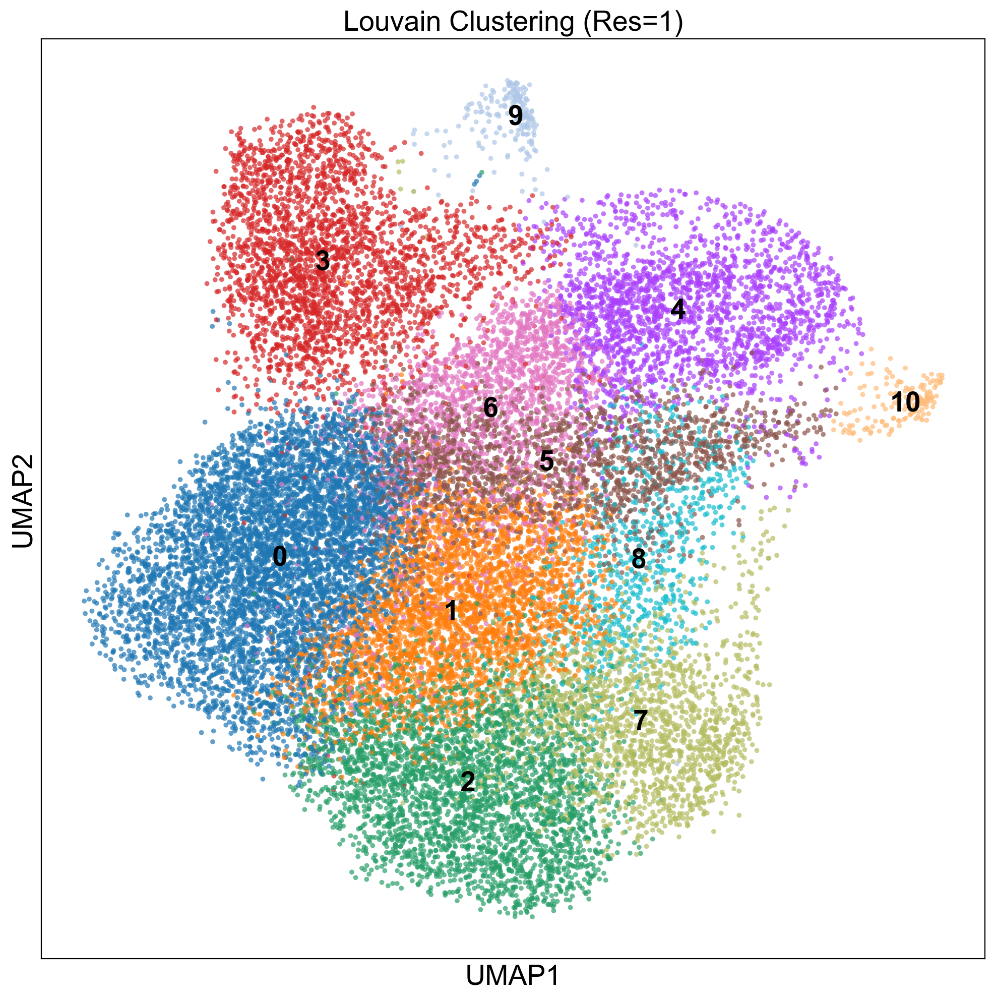

In [3]:

sc.pl.umap(adata, color="louvain", size=50, alpha=0.7, legend_loc="on data", title="Louvain Clustering (Res=1)")


In [4]:
# find differenetially expressed genes between cell types
# sc.pp.log1p(adata)
sc.tl.rank_genes_groups(adata, 'louvain', method='wilcoxon', n_genes=250)
sc.pl.rank_genes_groups(adata, n_genes=100, sharey=False)
# print the list of genes from group 5


ranking genes


KeyError: 'base'

In [ ]:
# print the genes from 5 vs rest
# print(adata.uns['rank_genes_groups']['names'])
# get the genes from the sixth values in every list
list = []
for item in adata.uns['rank_genes_groups']['names']:
    print(item[5])
    list.append(item[5])

# save list to csv
df = pd.DataFrame(list)
df.to_csv('write/genes.csv')


RPS2
RPLP1
RPS18
RPS4X
GAPDH
RPL10
RPL13
RPL7A
RPL8
RPL29
RPL3
RPL19
RPS7
EEF1A1
RPL41
VIM
RPS27A
RPS14
RPS12
RPS6
RPL18
RPL18A
RPS15
RPS3
RPLP0
RPS24
RPS19
RPL30
RPL13A
RPS9
PTN
RPS3A
RPL36
RPS28
RPL32
RPL28
IGFBP2
RPL14
RPL37A
RPS21
RPL34
RPL11
RPS23
RACK1
SOX2-OT
RPL10A
RPL35A
RPL37
RPS5
RPL27A
RPL35
RPL12
CKB
RPS11
RPL9
RPL6
RPL15
RPS16
PTMA
RPL24
RPL39
RPS8
RPL23A
RPSA
ACTG1
RPL23
RPS27
NACA
SEC61G-DT
IGFBP5
RPL5
RPS20
TUBA1A
HSP90AB1
TMSB4X
FAU
UBA52
RPL26
RPS15A
RPLP2
RPS29
SEC61G
ACTB
RPS10
TMSB10
FTL
TPT1
NPM1
RPL7
SLC25A6
RPS13
LGALS1
EEF1B2
RPL38
RPL27
ENO1
MZT2B
FTH1
EIF1
TUBA1B
TENM3
BSG
UBB
NDUFA4L2
TPI1
MAP2
SNHG29
RPL21
LRP1B
EGFR
ENSG00000258081
EEF2
NOVA1
BTF3
MT-CO3
FABP7
CD63
EEF1D
GPM6A
RPL4
RPL36AL
HSP90AA1
CHCHD2
RPL22L1
GSTP1
SOX5
ENSG00000239381
RPL31
HINT1
RPS25
LDHB
GREB1L
SNHG25
GRIA4
HLA-A
MYC
MIF
SLC25A5
SSR4
ENSG00000241231
GAS5
ATP5F1E
GPX4
PPIA
RPL36A
FLNA
MAML3
C19orf53
PLD5
S100A10
CCDC85B
PPIB
CIRBP
TSPO
PRDX4
RAN
MZT2A
BNIP3
NDUFB11
HNRNPA1
ARL15
GP

In [ ]:
# sc.pl.umap(adata, color="batch", size=50, alpha=0.7, legend_loc="on data", title="Sample Effects (Res=1)")


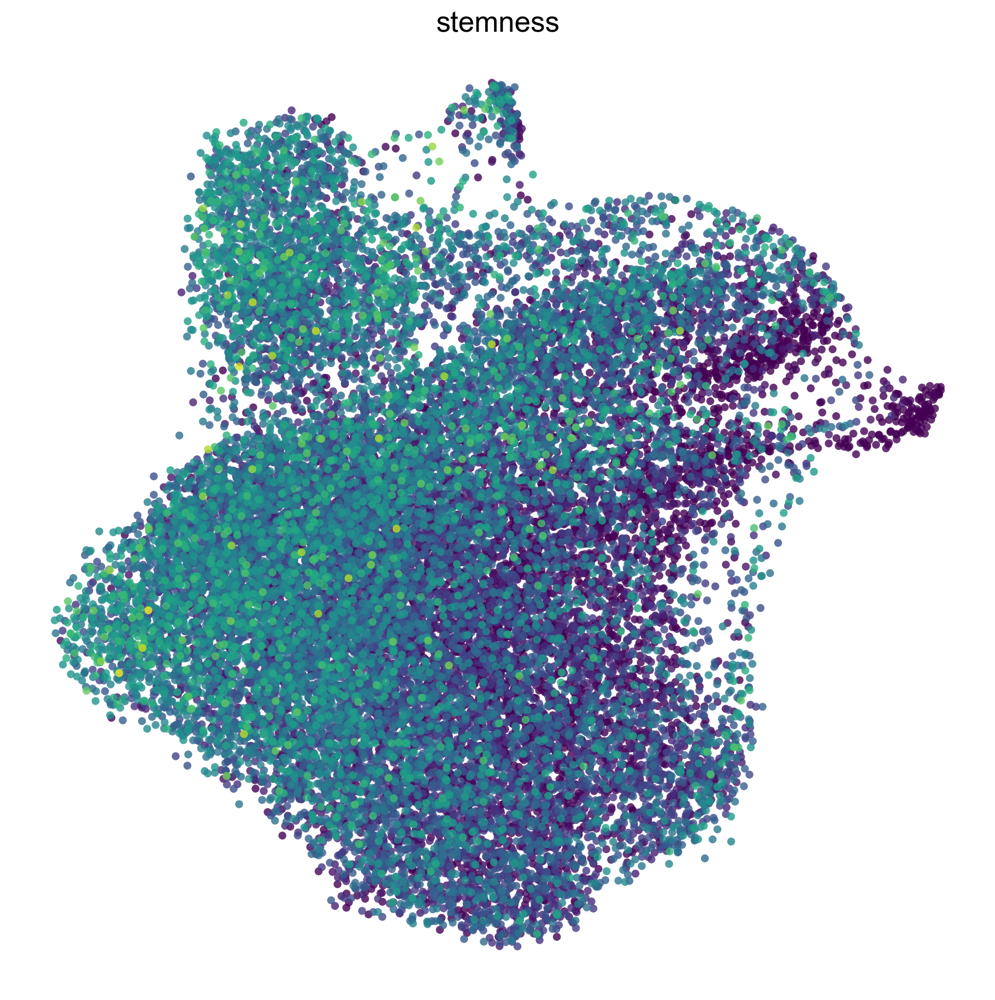

In [14]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, stemness].X.toarray()
except KeyError:
    stemness = [g for g in stemness if g in adata.var_names]
    data = adata[:, stemness].X.toarray()
    
stemness_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(stemness_expression=pd.Series(stemness_expression, index=adata.obs.index))
# sc.pl.umap(adata, color='stemness_expression', vmin=10, size=120, alpha=0.8, title='stemness', cmap='RdBu_r', frameon=False, legend_loc=None, colorbar_loc=None)
sc.pl.umap(adata, color='stemness_expression', vmin=20,size=120, alpha=0.8, title='stemness', frameon=False, legend_loc=None, colorbar_loc=None)

# remove colorbar



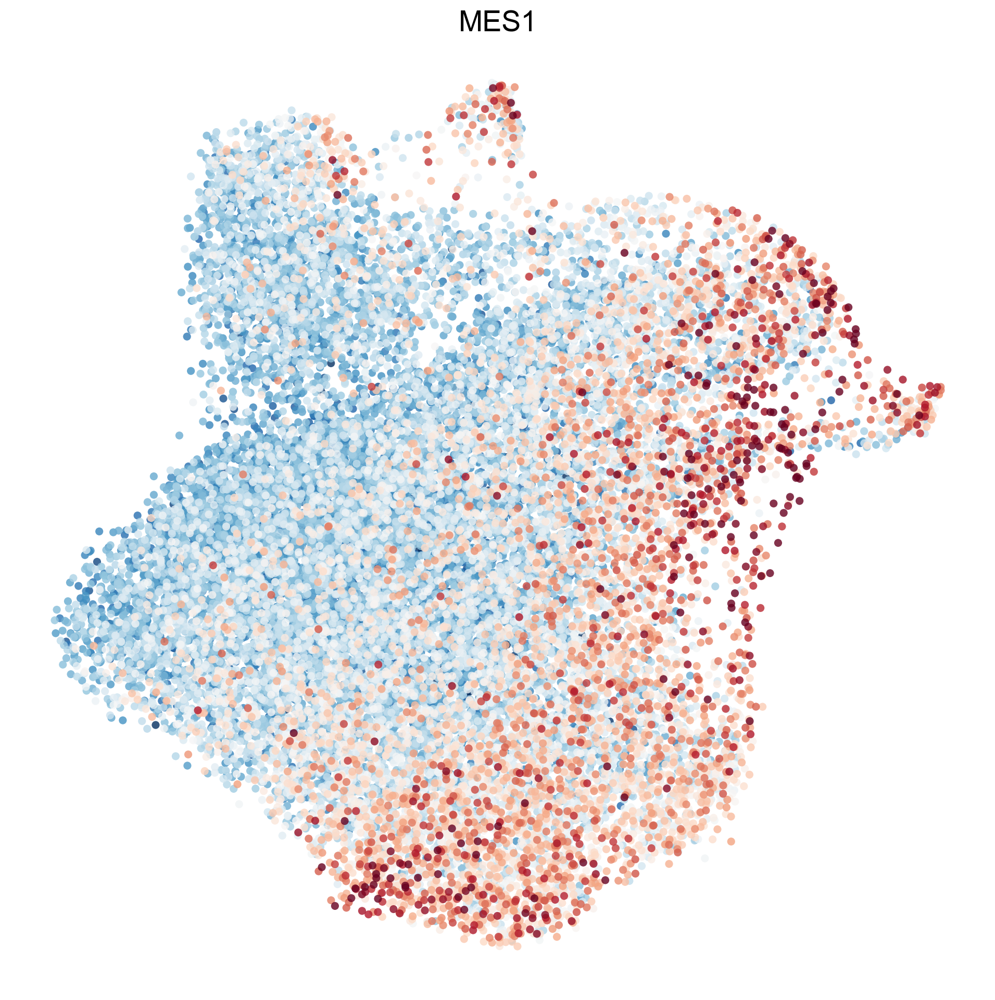

In [9]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, mes1].X.toarray()
except KeyError:
    mes1 = [g for g in mes1 if g in adata.var_names]
    data = adata[:, mes1].X.toarray()
    
mes1_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(mes1_expression=pd.Series(mes1_expression, index=adata.obs.index))
sc.pl.umap(adata, color='mes1_expression', vmin=0, vmax=30, size=120, alpha=0.8, title='MES1', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



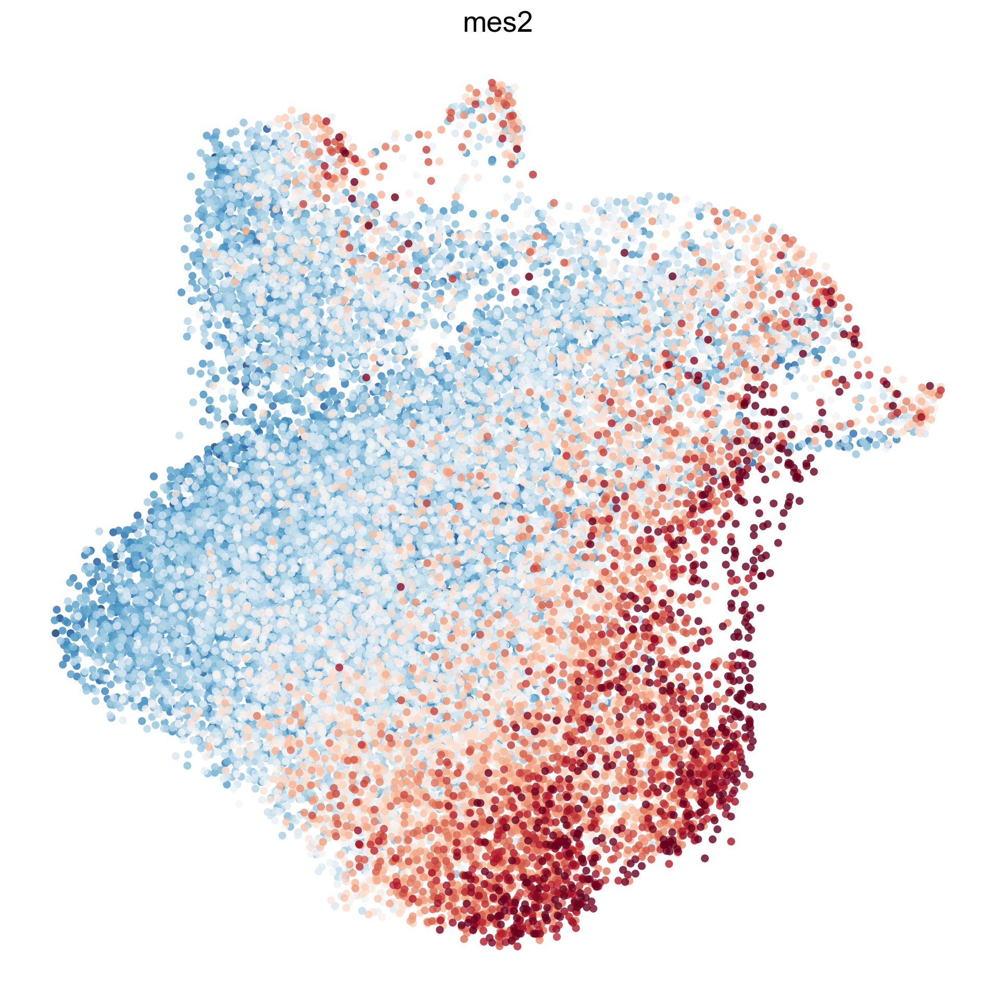

In [11]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, mes2].X.toarray()
except KeyError:
    mes2 = [g for g in mes2 if g in adata.var_names]
    data = adata[:, mes2].X.toarray()
    
mes2_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(mes2_expression=pd.Series(mes2_expression, index=adata.obs.index))
sc.pl.umap(adata, color='mes2_expression', vmin=0, vmax=40, size=120, alpha=0.8, title='mes2', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



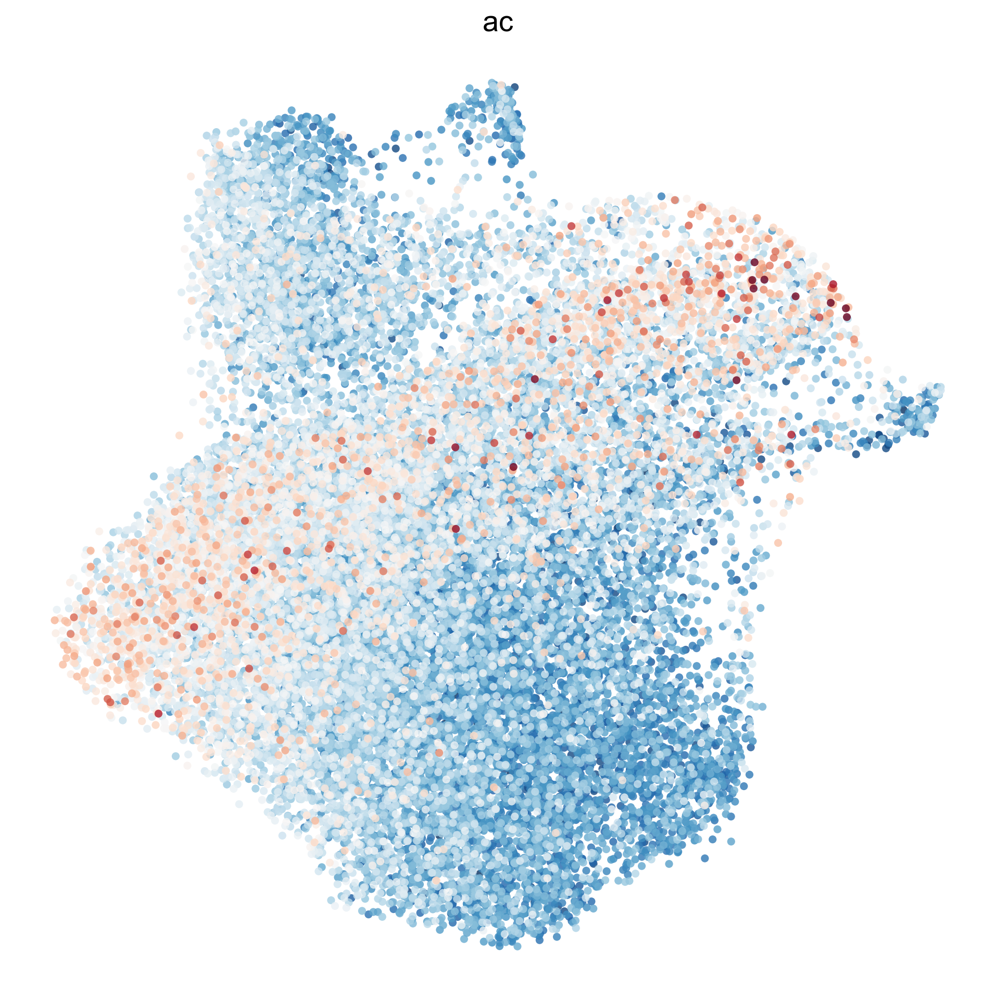

In [12]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, ac].X.toarray()
except KeyError:
    ac = [g for g in ac if g in adata.var_names]
    data = adata[:, ac].X.toarray()
    
ac_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(ac_expression=pd.Series(ac_expression, index=adata.obs.index))
sc.pl.umap(adata, color='ac_expression',vmax=30, size=120, alpha=0.8, title='ac', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



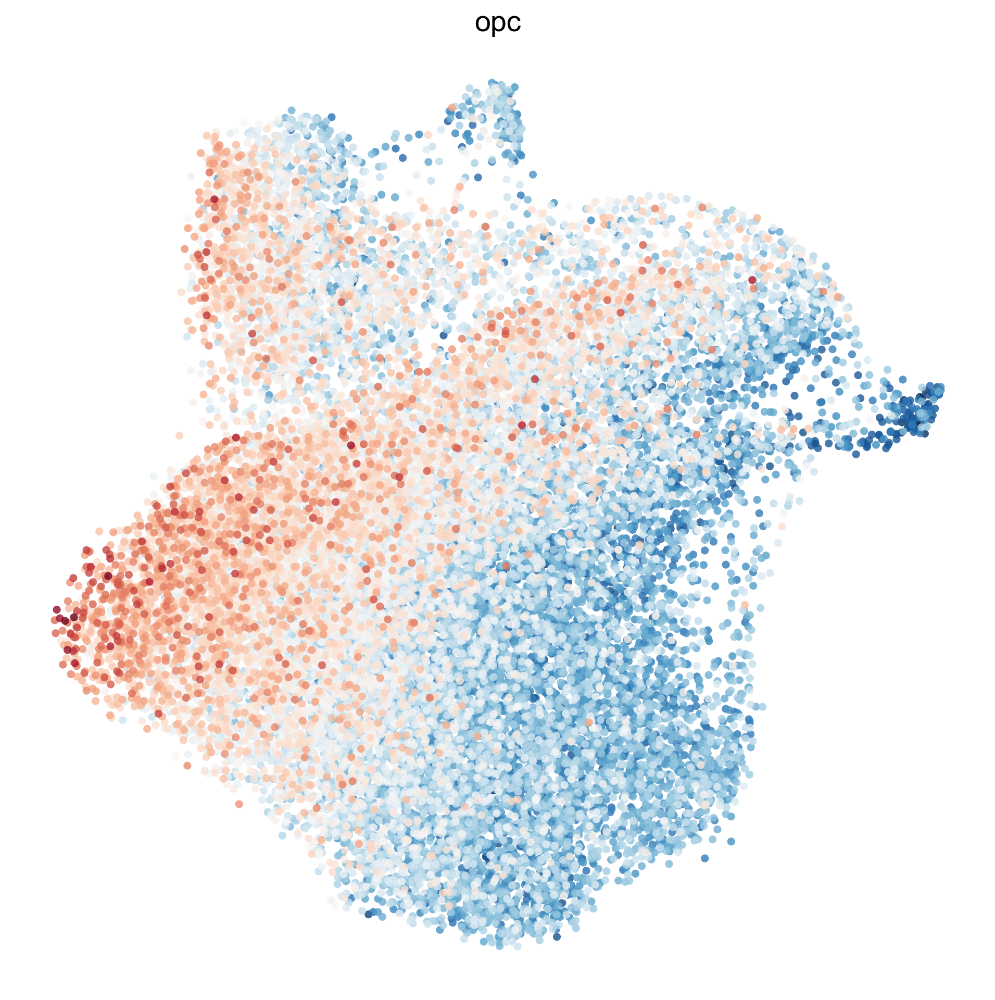

In [13]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, opc].X.toarray()
except KeyError:
    opc = [g for g in opc if g in adata.var_names]
    data = adata[:, opc].X.toarray()
    
opc_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(opc_expression=pd.Series(opc_expression, index=adata.obs.index))
sc.pl.umap(adata, color='opc_expression', size=120, alpha=0.8, title='opc', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



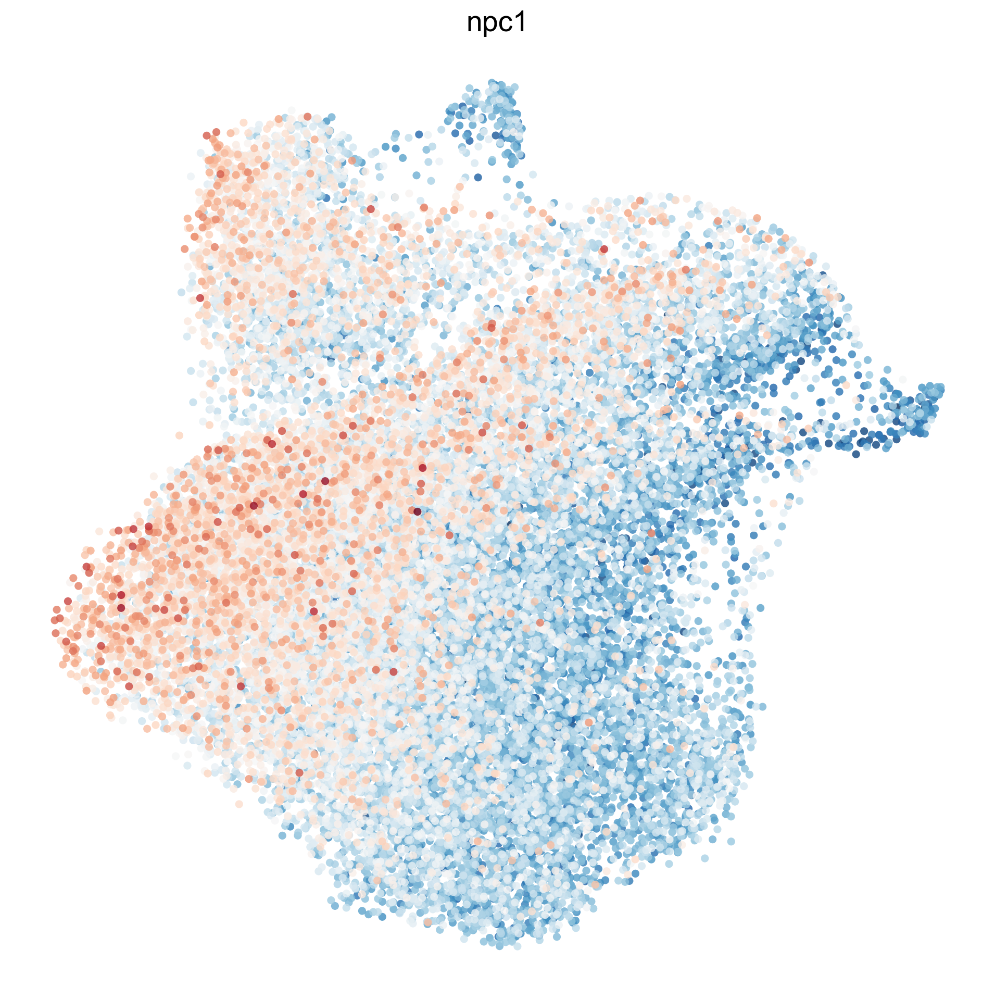

In [14]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, npc1].X.toarray()
except KeyError:
    npc1 = [g for g in npc1 if g in adata.var_names]
    data = adata[:, npc1].X.toarray()
    
npc1_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(npc1_expression=pd.Series(npc1_expression, index=adata.obs.index))
sc.pl.umap(adata, color='npc1_expression', size=120, alpha=0.8, title='npc1', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



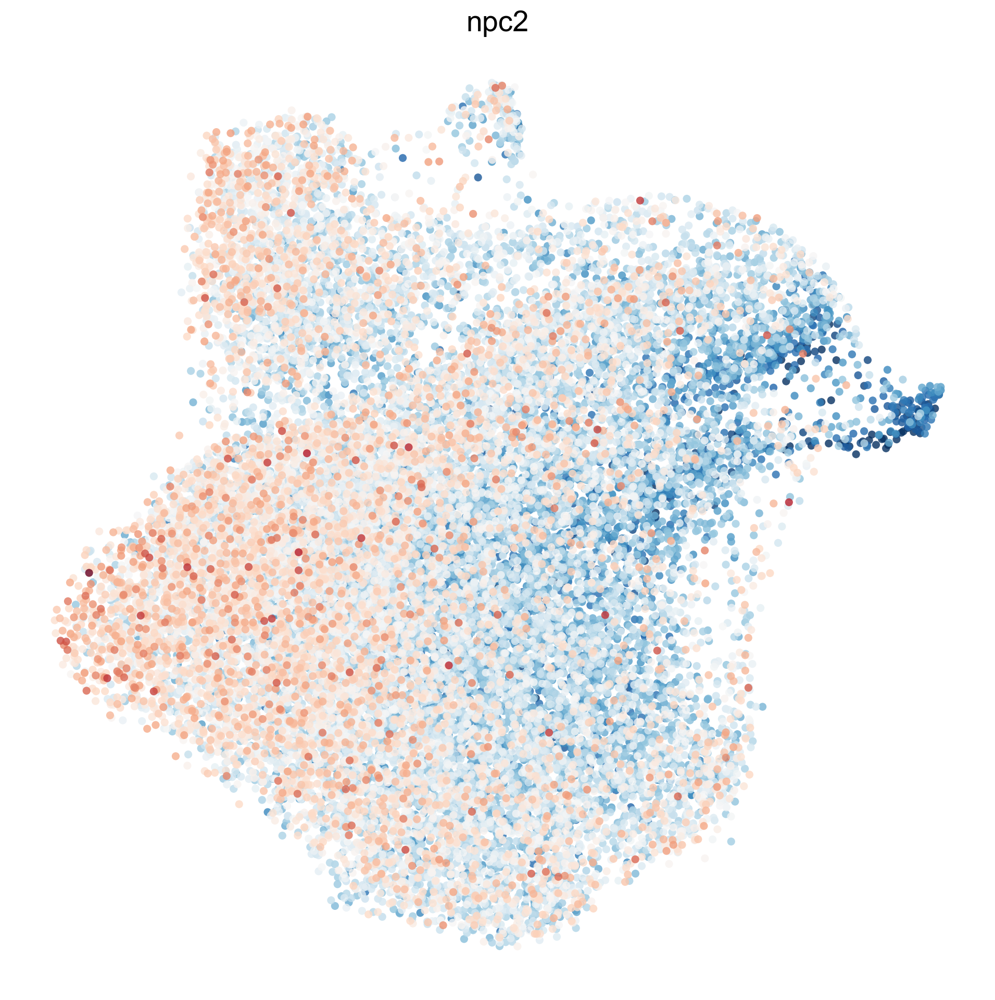

In [15]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, npc2].X.toarray()
except KeyError:
    npc2 = [g for g in npc2 if g in adata.var_names]
    data = adata[:, npc2].X.toarray()
    
npc2_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(npc2_expression=pd.Series(npc2_expression, index=adata.obs.index))
sc.pl.umap(adata, color='npc2_expression', size=120, alpha=0.8, title='npc2', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



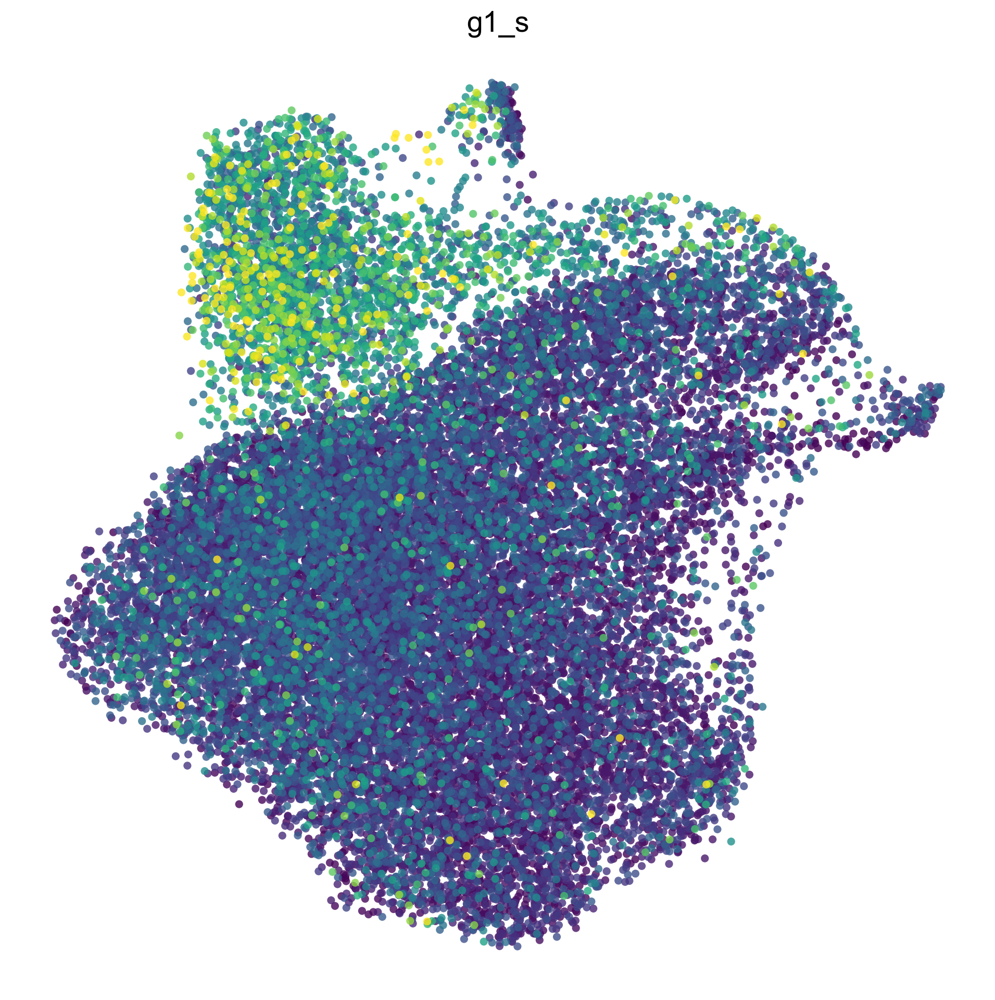

In [5]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, g1_s].X.toarray()
except KeyError:
    g1_s = [g for g in g1_s if g in adata.var_names]
    data = adata[:, g1_s].X.toarray()
    
g1_s_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(g1_s_expression=pd.Series(g1_s_expression, index=adata.obs.index))
# sc.pl.umap(adata, color='g1_s_expression', vmax=15, size=120, alpha=0.8, title='g1_s', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)
sc.pl.umap(adata, color='g1_s_expression', vmax=15, size=120, alpha=0.8, title='g1_s' ,frameon=False, legend_loc=None, colorbar_loc=None)




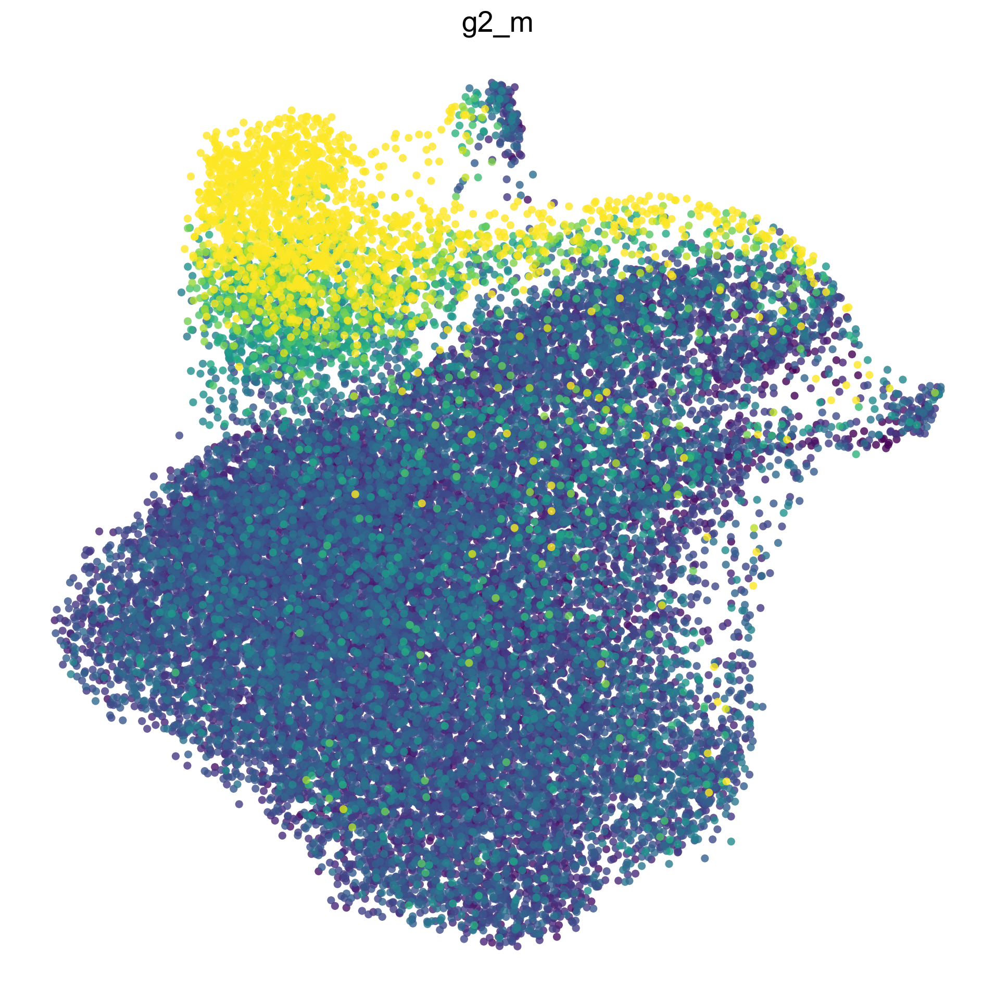

In [6]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, g2_m].X.toarray()
except KeyError:
    g2_m = [g for g in g2_m if g in adata.var_names]
    data = adata[:, g2_m].X.toarray()
    
g2_m_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(g2_m_expression=pd.Series(g2_m_expression, index=adata.obs.index))
# sc.pl.umap(adata, color='g2_m_expression', vmax=20, size=120, alpha=0.8, title='g2_m', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)
sc.pl.umap(adata, color='g2_m_expression', vmax=20, size=120, alpha=0.8, title='g2_m' ,frameon=False, legend_loc=None, colorbar_loc=None)



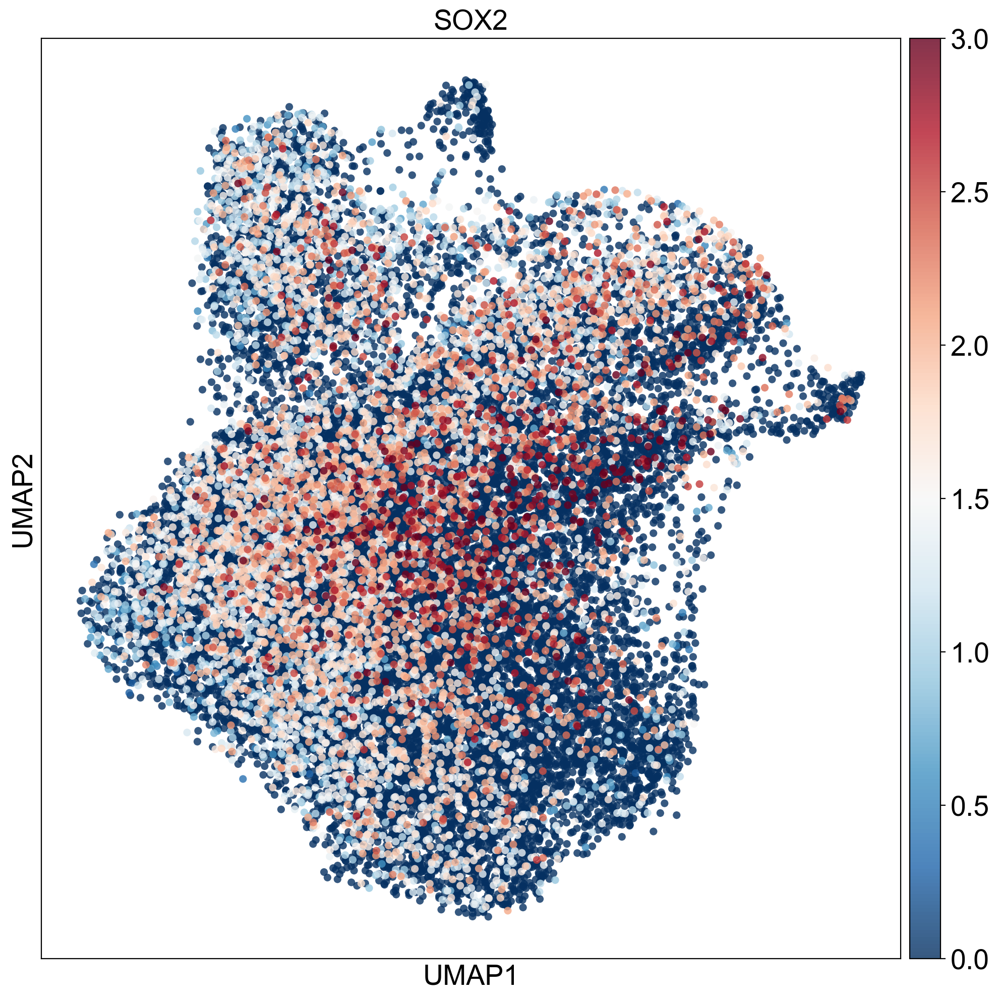

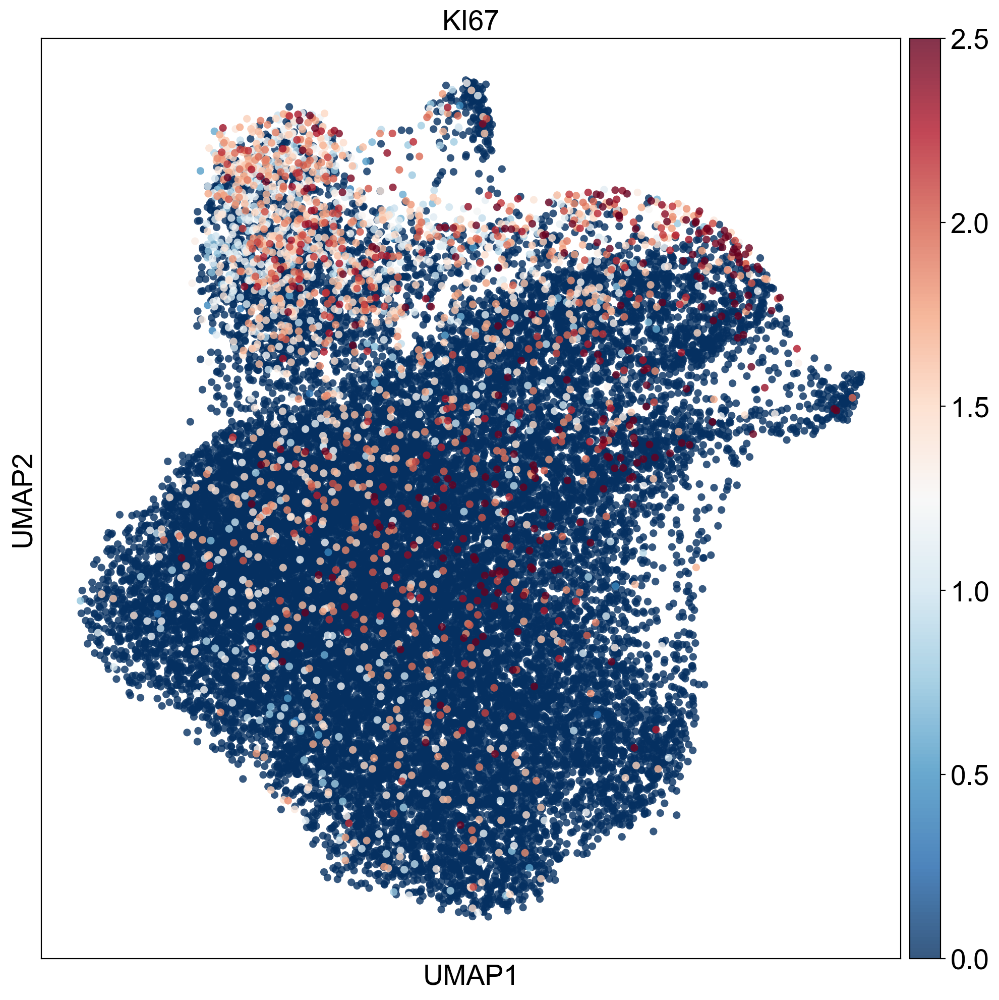

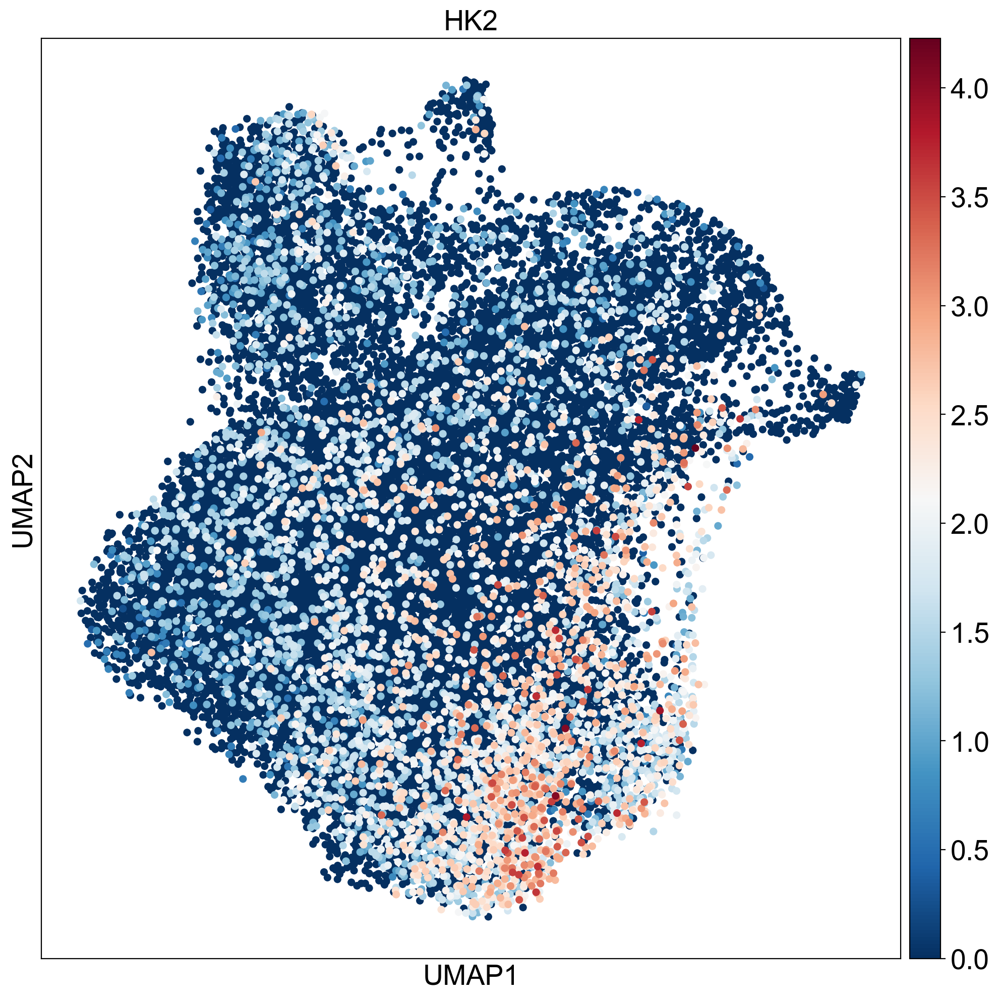

In [10]:

sc.pl.umap(adata, color='SOX2', size=120, vmax=3, alpha=0.8, title='SOX2', cmap='RdBu_r')
sc.pl.umap(adata, color='MKI67', size=120, vmax=2.5, alpha=0.8, title='KI67', cmap='RdBu_r')

sc.pl.umap(adata, color='HK2', size=120, title='HK2', cmap='RdBu_r')



In [84]:
# drop cell_type_f
adata.obs = adata.obs.drop(columns=['cell_type_f'])
# # Annotating types
adata.obs.loc[adata.obs.louvain == '2', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.louvain == '7', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.louvain == '8', 'cell_type_f'] = 'Mesenchymal'



adata.obs.loc[adata.obs.louvain == '4', 'cell_type_f'] = 'Astrocyte'
adata.obs.loc[adata.obs.louvain == '10', 'cell_type_f'] = 'Astrocyte'



adata.obs.loc[adata.obs.louvain == '5', 'cell_type_f'] ='Cancer Stem Cell' 



adata.obs.loc[adata.obs.louvain == '0', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'
adata.obs.loc[adata.obs.louvain == '1', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'
adata.obs.loc[adata.obs.louvain == '6', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'
adata.obs.loc[adata.obs.louvain == '3', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'




adata.obs.loc[adata.obs.louvain == '9', 'cell_type_f'] = 'Endothelial'



/Users/shaunie/anaconda3/envs/hu-aging/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


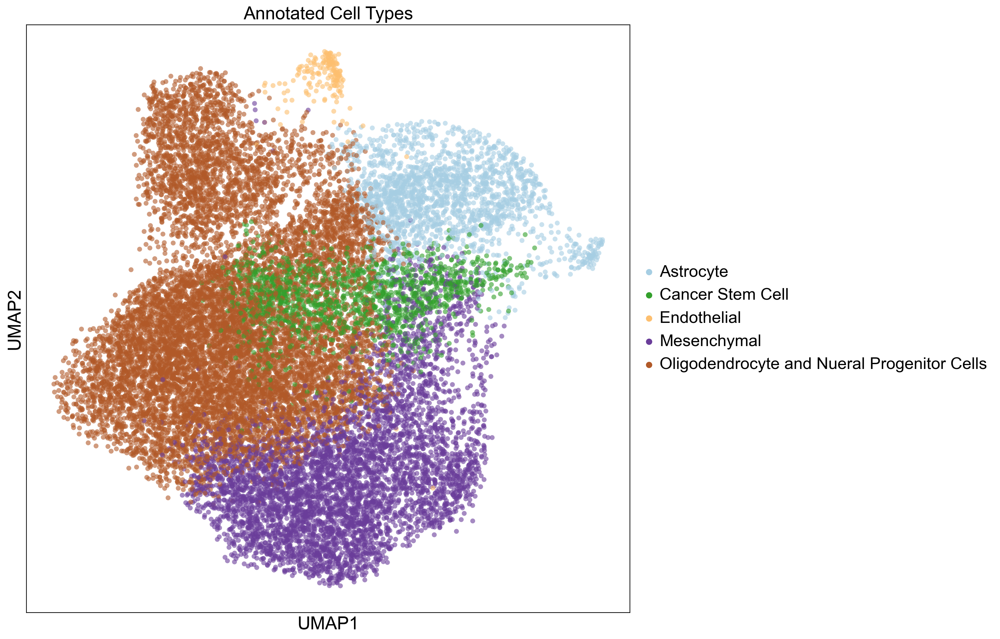

In [122]:
# add opacity
# choose colorblind friendly colors

sc.pl.umap(adata, color="cell_type_f", title="Annotated Cell Types", size=120, alpha=0.6, palette="Paired")

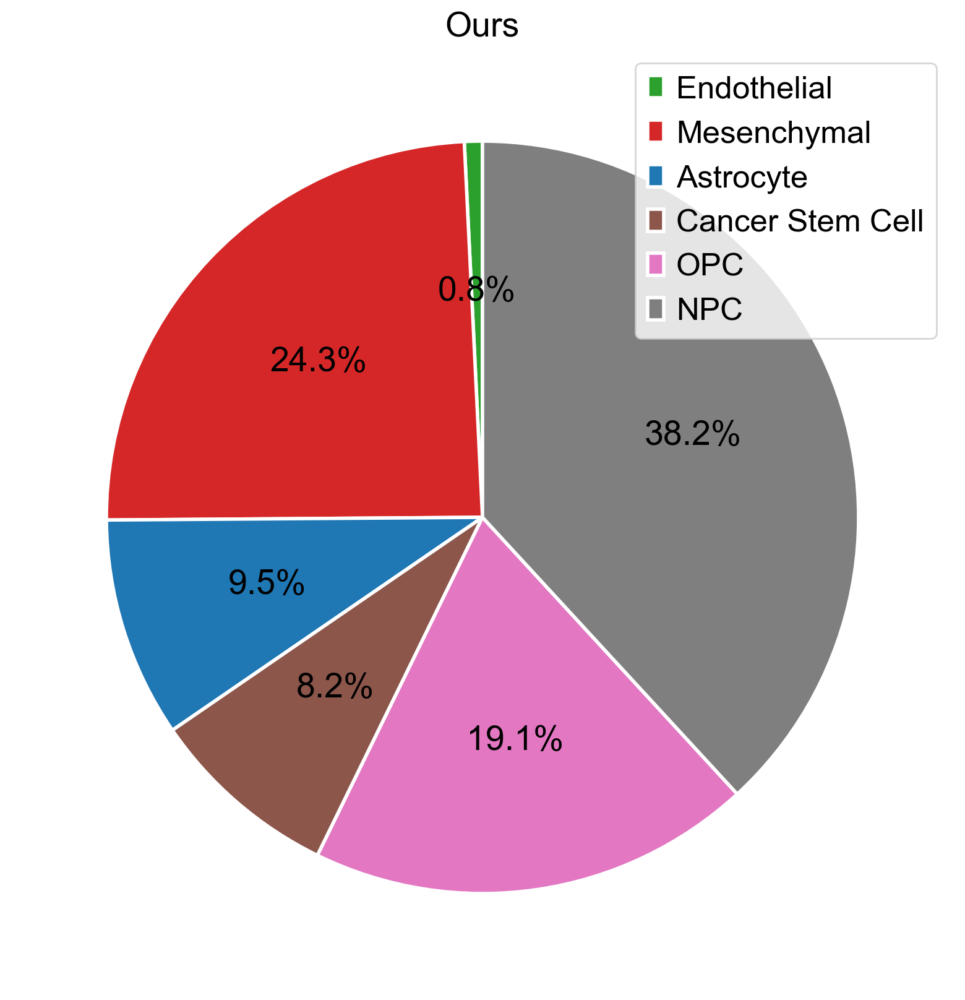

In [87]:

# use the following order and colors:

# make a dataframe of the cell types
cell_type_df = pd.DataFrame(adata.obs['cell_type_f'].value_counts())
# split progenitor values into two, 2/3 are NPC and 1/3 are OPC
cell_type_df.loc['OPC'] = cell_type_df.loc['Oligodendrocyte and Nueral Progenitor Cells']/3
cell_type_df.loc['NPC'] = 2*cell_type_df.loc['Oligodendrocyte and Nueral Progenitor Cells']/3
cell_type_df = cell_type_df.drop(['Oligodendrocyte and Nueral Progenitor Cells'])
# # rename the progenitor values
cell_type_df = cell_type_df.rename(index={'OPC': 'OPC', 'NPC': 'NPC'})

# # reorder to Endothelial, Mesenchymal, OPC-like, Astrocyte-like, Proneural-like
cell_type_df = cell_type_df.reindex(['Endothelial', 'Mesenchymal','Astrocyte', 'Cancer Stem Cell', 'OPC', 'NPC'])



# make a pie chart of the cell types, remove the labels from the chart itself, outline black, percentage to 1 decimal place and farther out
cell_type_df.plot.pie(y='cell_type_f', figsize=(20, 10), colors=palette_8.values(), autopct='%1.1f%%', startangle=90, legend=True, fontsize=20, title='Ours', ylabel='', labeldistance=None, wedgeprops=dict(linewidth=2, edgecolor='white'), textprops={'fontsize': 20})
# save figure   
plt.savefig('figures/pie_chart_our_classifications.png', bbox_inches='tight', dpi=300)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:48)


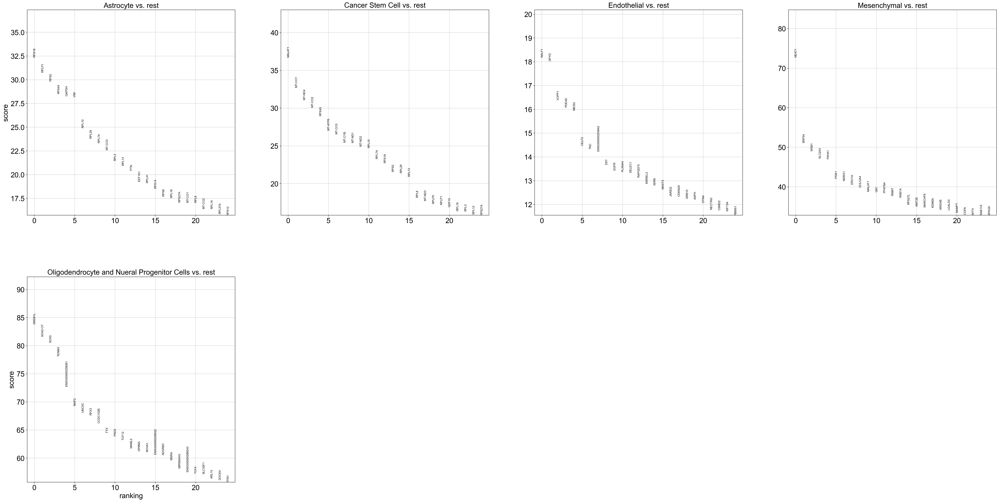

In [ ]:
# find differenetially expressed genes between cell types
sc.tl.rank_genes_groups(adata, 'cell_type_f', method='wilcoxon', n_genes=250)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)


In [90]:
adata2 = adata.copy()

In [91]:
adata = adata2.copy()
adata# if perivascular if over 3.5, label class "perivascular"
adata.obs["class"] = 'other'
adata.obs["class"] = np.where(adata.obs['mes_expression'] > 1.5, "Mesenchymal", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['ac_expression'] > 1, "Astrocyte", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['opc_expression'] > 0.8, "OPC", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['npc_expression'] > 1.8, "NPC", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['endo_expression'] > 0.6, "Endothelial", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['stem_expression'] > 1.5, "Cancer Stem Cell", adata.obs["class"])



# drop everything other
adata = adata[adata.obs["class"] != "other", :]

adata.obs["class"] = pd.Categorical(adata.obs["class"], categories=["Astrocyte", "Mesenchymal", "OPC", "NPC","Endothelial", "Cancer Stem Cell",'other'])


/var/folders/td/y1xv90r510924xxsnlfkjgrc0000gn/T/ipykernel_36429/542760007.py:16: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["class"] = pd.Categorical(adata.obs["class"], categories=["Astrocyte", "Mesenchymal", "OPC", "NPC","Endothelial", "Cancer Stem Cell",'other'])


In [92]:
adata.obs

,batch,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,leiden,louvain,mes_expression,ac_expression,opc_expression,endo_expression,npc_expression,stem_expression,cell_type_f,class
AAACCCACAAAGGAGA-1-1914_human,1914_human,2338,2338,4497.0,44.0,0.978430,4,1,-0.122302,0.004312,1.134452,-0.004934,3.701396,1.260610,Oligodendrocyte and Nueral Progenitor Cells,NPC
AAACCCAGTTGTCCCT-1-1914_human,1914_human,4193,4192,9235.0,2.0,0.021657,0,0,0.606879,1.254610,1.115611,-0.004934,2.980461,-0.075327,Oligodendrocyte and Nueral Progenitor Cells,NPC
AAACGAAAGCTCATAC-1-1914_human,1914_human,3384,3384,7311.0,5.0,0.068390,1,0,-0.122302,0.004312,0.814410,-0.004934,1.262317,-0.075327,Oligodendrocyte and Nueral Progenitor Cells,OPC
AAACGCTAGTAGTGCG-1-1914_human,1914_human,1793,1793,3368.0,3.0,0.089074,7,7,3.038689,0.004312,-0.079600,-0.004934,-0.007766,-0.075327,Mesenchymal,Mesenchymal
AAAGAACGTCGTCAGC-1-1914_human,1914_human,3206,3206,5869.0,4.0,0.068155,0,0,0.866213,0.004312,-0.079600,-0.004934,1.252324,2.338551,Oligodendrocyte and Nueral Progenitor Cells,Cancer Stem Cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGAGATCCAAA-1-1919d_human,1919d_human,3948,3948,7850.0,61.0,0.777070,12,6,0.238836,-0.018428,-0.011150,-0.000546,1.823428,0.773811,Oligodendrocyte and Nueral Progenitor Cells,NPC
TTTGTTGAGCCTCCAG-1-1919d_human,1919d_human,1062,1062,1594.0,21.0,1.317440,3,3,0.238836,-0.018428,-0.011150,-0.000546,1.828319,-0.041701,Oligodendrocyte and Nueral Progenitor Cells,NPC
TTTGTTGGTGTAGTGG-1-1919d_human,1919d_human,2484,2484,4690.0,5.0,0.106610,9,5,2.885165,1.198470,-0.011150,-0.000546,1.304437,1.607178,Cancer Stem Cell,Cancer Stem Cell
TTTGTTGTCCATACTT-1-1919d_human,1919d_human,1155,1155,1594.0,115.0,7.214554,5,6,0.238836,1.851059,-0.011150,-0.000546,-0.086313,-0.041701,Oligodendrocyte and Nueral Progenitor Cells,Astrocyte


<Figure size 2000x2000 with 0 Axes>

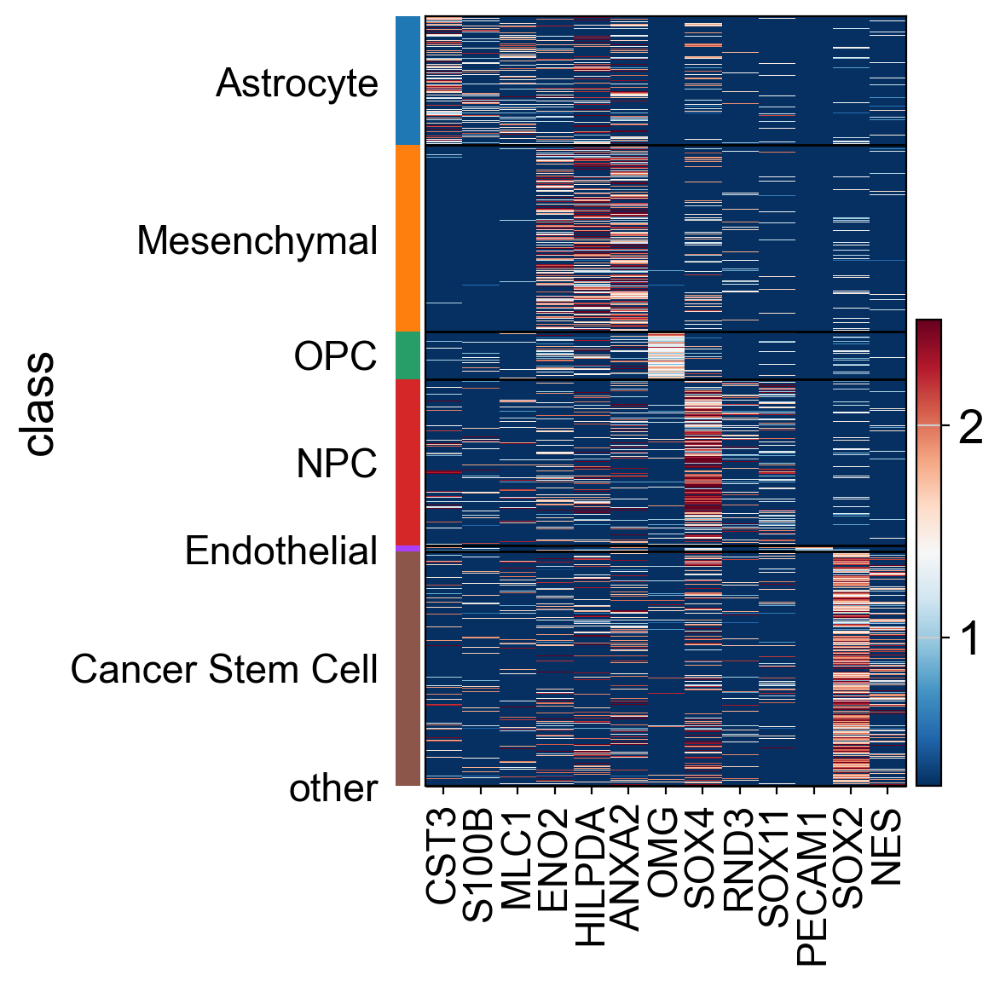

In [105]:

# make a heatmap of the cell types
# average adata into bins matching cell_type_f

# take a random 1/10th of the data
# adata_sample = adata[np.random.choice(adata.shape[0], int(adata.shape[0]/1), replace=False), :]

fig = plt.figure(figsize=(20, 20))

# log normalize the data
# sc.pp.log1p(adata)

sc.pl.heatmap(adata, var_names=all_genes, groupby='class', vmin=0.3, vmax=2.5, cmap='RdBu_r')
# save figure
fig.savefig('figures/heatmap_our_classifications.png', bbox_inches='tight', dpi=300)
